# **Mount the Google drive**
The trained models are uploaded to the google drive and inorder to load them the drive is mounted.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/HelmetDetection

/content/drive/MyDrive/HelmetDetection


# **Import the required packages**

In [ ]:
# clone Tensorflow object detection api
!git clone https://github.com/tensorflow/models

fatal: destination path 'models' already exists and is not an empty directory.


In [ ]:
# Run to install proto buffers for object detection api
!apt-get update
!apt-get install -y protobuf-compiler python3-pil python3-lxml
!pip install protobuf
!pip uninstall tensorflow


Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [110 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [119 kB]
Get:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [783 kB]
Hit:7 https://ppa.launchpadcontent.net/c2d4u.team/c2d4u4.0+/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Hit:11 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Get:12 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,080 kB]
Get:13 http://archive.ubuntu.com/ub

In [ ]:
!pip install tensorflow==2.8

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 497.6/497.6 MB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 42.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 462.5/462.5 kB 43.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 46.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 44.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 781.3/781.3 kB 46.1 MB/s eta 0:00:00
  Attempting uninstall: keras
    Found existing installation: keras 2.15.0
    Uninstalling keras-2.15.0:
      Successfully uninstalled keras-2.15.0
  Attempting uninstall: tensorboard-data-server
    Found existing installation: tensorboard-data-server 0.7.2
    Uninstalling tensorboard-data-server-0.7.2:
      Successfully uninstalled tensorboard-data-server-0.7.2
  Attempting uninstall: google-auth-oauthlib
    Found existing 

In [ ]:
import sys
sys.path.append('/content/drive/MyDrive/HelmetDetection/models/research/slim')
!pip install tf_slim

In [ ]:
%cd /content/drive/MyDrive/HelmetDetection/models/research
!protoc object_detection/protos/*.proto --python_out=.

/content/drive/MyDrive/HelmetDetection/models/research


In [ ]:
# Import packages
import os
import cv2
import numpy as np
import tensorflow as tf
import sys
from google.colab.patches import cv2_imshow


# Import utilites
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [ ]:
pwd

'/content/drive/MyDrive/HelmetDetection/models/research'

# **Configure the paths to trained models**
A Faster RCNN model is trained to detect motorcyclists in a given image.

A YOLO model is trained to detect helmet in the given image of motorcyclist.



In [ ]:
CWD_PATH = '/content/drive/MyDrive/HelmetDetection/'

MODEL_RCNN = 'rcnn'

MODEL_YOLO='yolo'

# Path to frozen detection graph .pb file, which contains the model that is used
# for rcnn object detection.
PATH_TO_CKPT = os.path.join(CWD_PATH,MODEL_RCNN,'frozen_inference_graph.pb')

# Path to label map file
PATH_TO_LABELS = os.path.join(CWD_PATH,MODEL_RCNN,'label_map.pbtxt')

# Path to yolo files
configPath=os.path.join(CWD_PATH,MODEL_YOLO,'yolov3_custom.cfg')
weightsPath=os.path.join(CWD_PATH,MODEL_YOLO,'yolov3_custom_4000.weights')
labelsPath=os.path.join(CWD_PATH,MODEL_YOLO,'obj.names')


# **Configure the input and output paths**

Images of Motorcyclists without helmet are stored in the Output folder.


In [ ]:
# Path to input image
IMAGE_NAME = 'input/images/sample.jpeg'

# Path to input video
VIDEO_NAME = 'input/videos/clip.mp4'

OUTPUT_FOLDER='output/'

# Path to output
PATH_TO_OUTPUT = os.path.join(CWD_PATH, OUTPUT_FOLDER,'/images')
VIDEO_OUTPUT = os.path.join(CWD_PATH, OUTPUT_FOLDER,'output_clip.mp4')

# Path to image
PATH_TO_IMAGE = os.path.join(CWD_PATH,IMAGE_NAME)

# Path to video
PATH_TO_VIDEO = os.path.join(CWD_PATH,VIDEO_NAME)

# **Configure Faster RCNN Model**

In [ ]:

# Load the label map.
# Label maps map indices to category names
# Here we use internal utility functions
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=1, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

# Load the Tensorflow model into memory.
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.compat.v1.GraphDef()
    with tf.compat.v2.io.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')
    sess = tf.compat.v1.Session(graph=detection_graph)

# Define input and output data for the object detection classifier

# Input tensor is the image
image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')

# Output tensors are the detection boxes, scores, and classes
# Each box represents a part of the image where a particular object was detected
detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')

# Each score represents level of confidence for each of the objects.
# The score is shown on the result image, together with the class label.
detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')

# Number of objects detected
num_detections = detection_graph.get_tensor_by_name('num_detections:0')

# **Configure YOLO Model**

In [ ]:

net = cv2.dnn.readNetFromDarknet(configPath, weightsPath)
ln = net.getLayerNames()
ln = [ln[i - 1] for i in net.getUnconnectedOutLayers()]
LABELS = open(labelsPath).read().strip().split("\n")

# **Detection Of Motorcyclists Without Helmet From Input Image**
The two models are integrated to detect the motorcyclists without helmet from the input image and the images of riders without helmet are stored in the output folder

In [ ]:
!pip install pytesseract
!sudo apt-get install tesseract-ocr
!pip install matplotlib
!pip install easyocr


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 39 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 1s (3,441 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debc

# **Detection Of Motorcyclists Without Helmet From Input Video Stream**
The two models are integrated to detect the motorcyclists without helmet from the input video stream and the images of riders without helmet are stored in the output folder, along with the resulting video stream

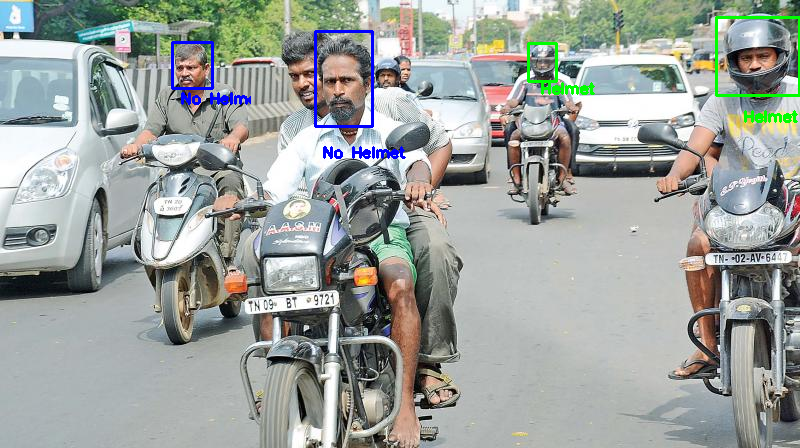

Precision: 1.0
Recall: 0.5
F1 Score: 0.6666666666666666


In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
import pytesseract

def calculate_metrics(true_positives, false_positives, false_negatives):
    precision = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
    recall = true_positives / (true_positives + false_negatives) if (true_positives + false_negatives) > 0 else 0
    f1_score = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0
    return precision, recall, f1_score

def plot_metrics(precision, recall, f1_score):
    labels = ['Precision', 'Recall', 'F1 Score']
    values = [precision, recall, f1_score]

    plt.bar(labels, values, color=['blue', 'green', 'orange'])
    plt.xlabel('Metrics')
    plt.ylabel('Score')
    plt.title('Precision, Recall, and F1 Score')

    # Displaying the values on the bars
    for i in range(len(labels)):
        plt.text(i, values[i], str(round(values[i], 2)), ha = 'center', va = 'bottom')

    plt.show()

def detect_helmet(image_path):
    true_positives = 0
    false_positives = 0
    false_negatives = 0

    # Load the image
    image = cv2.imread(image_path)
    image_expanded = np.expand_dims(image, axis=0)

    # Run the detection model
    (boxes, scores, classes, num) = sess.run(
        [detection_boxes, detection_scores, detection_classes, num_detections],
        feed_dict={image_tensor: image_expanded}
    )

    # Get normalized coordinates of boxes
    normalizedBoxes = np.squeeze(boxes)
    normalizedScores = np.squeeze(scores)
    normalizedClasses = np.squeeze(classes)

    # Set a min threshold score
    min_score_thresh = 0.8
    detectedBoxes = normalizedBoxes[normalizedScores > min_score_thresh]
    detectedClasses = normalizedClasses[normalizedScores > min_score_thresh]

    # Get image size
    im_height, im_width, _ = image.shape

    # Get original coordinates of bike riders in image
    final_boxes = []
    for i in range(len(detectedBoxes)):
        ymin, xmin, ymax, xmax = detectedBoxes[i]
        final_boxes.append([xmin * im_width, xmax * im_width, ymin * im_height, ymax * im_height])

    for [left, right, top, bottom] in final_boxes:
        l = int(round(left))
        r = int(round(right))
        t = int(round(top))
        b = int(round(bottom))
        croppedImage = image[t:b, l:r]  # Extract each bike rider

        # Perform padding to cropped image
        rows = croppedImage.shape[0]
        cols = croppedImage.shape[1]
        padding = 0
        if rows > cols:
            padding = int((rows - cols) / 2)
            paddedImg = cv2.copyMakeBorder(croppedImage, 0, 0, padding, padding, cv2.BORDER_CONSTANT, (0, 0, 0))
        else:
            paddedImg = croppedImage

        # Image preprocessing for YOLO model
        (H, W) = paddedImg.shape[:2]
        blob = cv2.dnn.blobFromImage(paddedImg, 1 / 255.0, (416, 416), swapRB=True, crop=False)

        # Run YOLO model
        net.setInput(blob)
        layerOutputs = net.forward(ln)

        # Initializing for getting box coordinates, confidences, classid
        boxesH = []
        confidencesH = []
        classIDsH = []
        thresholdH = 0.15

        # Getting coordinates of output predictions and performing NMS
        for output in layerOutputs:
            for detection in output:
                confidenceOfEachClass = detection[5:]
                classIDH = np.argmax(confidenceOfEachClass)  # Get class with max confidence
                confidenceH = confidenceOfEachClass[classIDH]  # Get the max confidence
                if confidenceH > thresholdH:
                    boxH = detection[0:4] * np.array([W, H, W, H])
                    (centerX, centerY, widthH, heightH) = boxH.astype("int")
                    x = int(centerX - (widthH / 2))
                    y = int(centerY - (heightH / 2))
                    boxesH.append([x, y, int(widthH), int(heightH)])
                    confidencesH.append(float(confidenceH))
                    classIDsH.append(classIDH)
        idxs = cv2.dnn.NMSBoxes(boxesH, confidencesH, thresholdH, 0.1)

        # Count true positives, false positives, and false negatives
        helmet_detected = False
        for i in idxs.flatten():
            (x, y) = (boxesH[i][0], boxesH[i][1])
            (w, h) = (boxesH[i][2], boxesH[i][3])
            if LABELS[classIDsH[i]] == 'Helmet':
                true_positives += 1
                helmet_detected = True
                color = (0, 255, 0)  # Green for helmet
            if LABELS[classIDsH[i]] == 'No Helmet':
                if helmet_detected:
                    false_positives += 1
                    color = (0, 0, 255)  # Red for no helmet
                else:
                    false_negatives += 1
                    color = (255, 0, 0)  # Blue for false negative

            # Draw bounding boxes
            cv2.rectangle(croppedImage, (x - padding, y), (x + w - padding, y + h), color, 2)
            text = "{}".format(LABELS[classIDsH[i]])
            cv2.putText(croppedImage, text, (x // 2, y + 4 * h // 3),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Display the image with bounding boxes and labels
    cv2_imshow(image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

    # Calculate precision, recall, and F1 score
    precision, recall, f1_score = calculate_metrics(true_positives, false_positives, false_negatives)

    # Plot the metrics
    # plot_metrics(precision, recall, f1_score)

    # Return the metrics
    return precision, recall, f1_score

# Call the function with the image path
precision, recall, f1_score = detect_helmet(PATH_TO_IMAGE)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)
plot_metrics(precision,recall,f1_score)

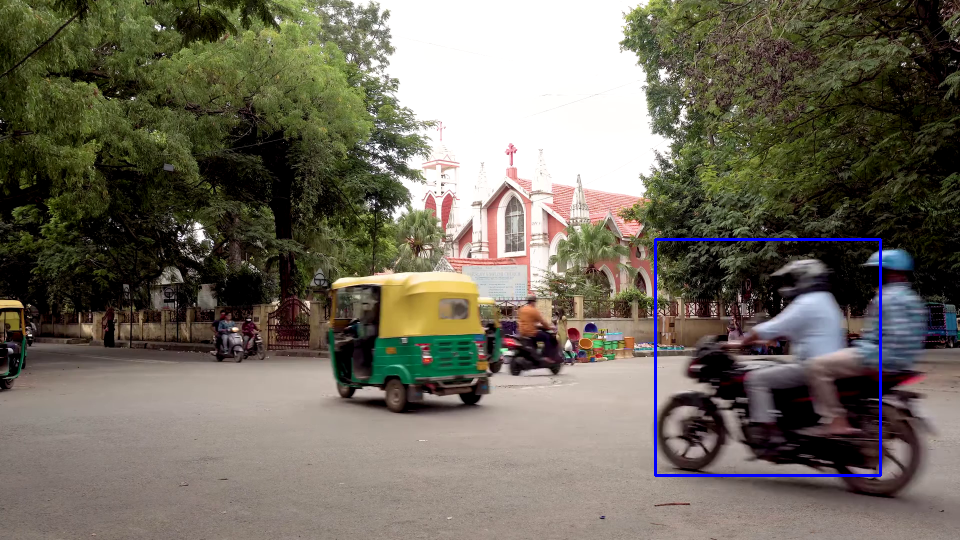

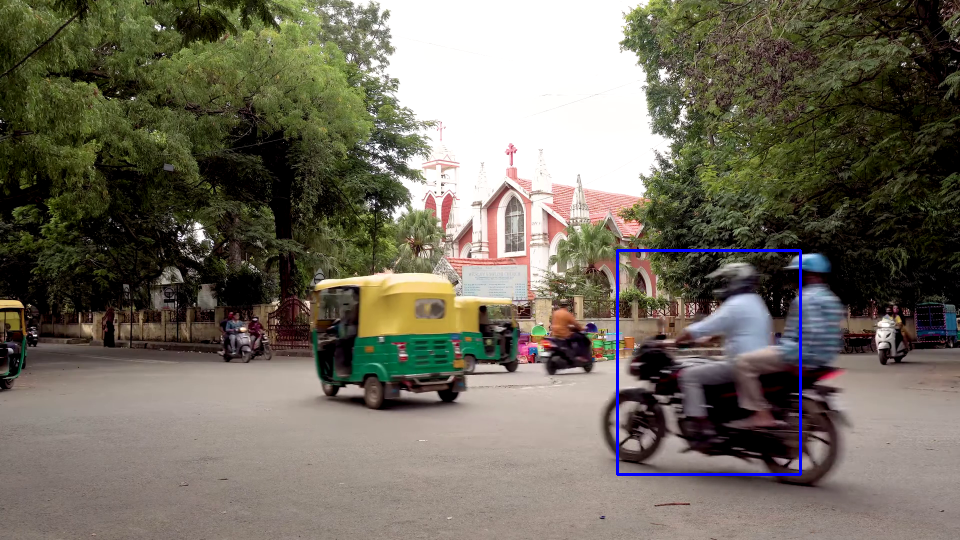

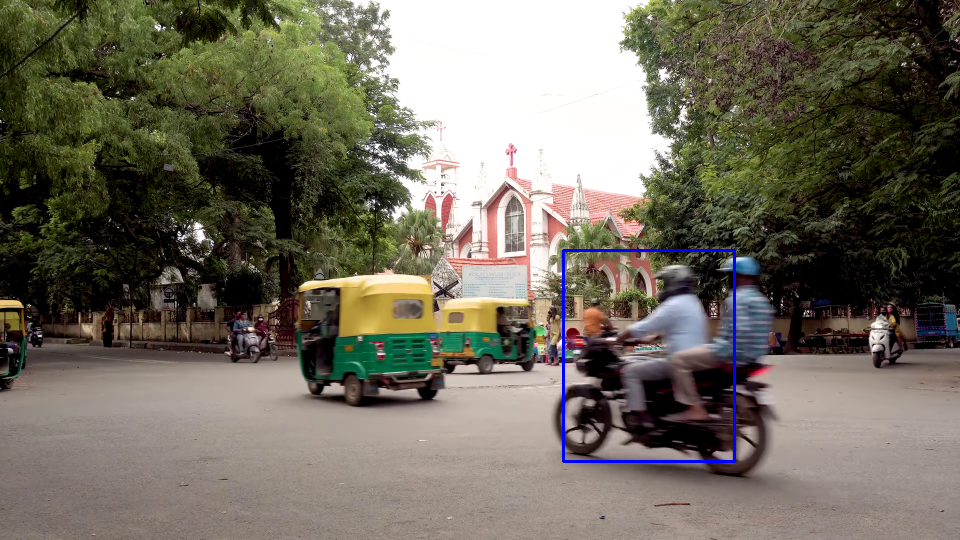

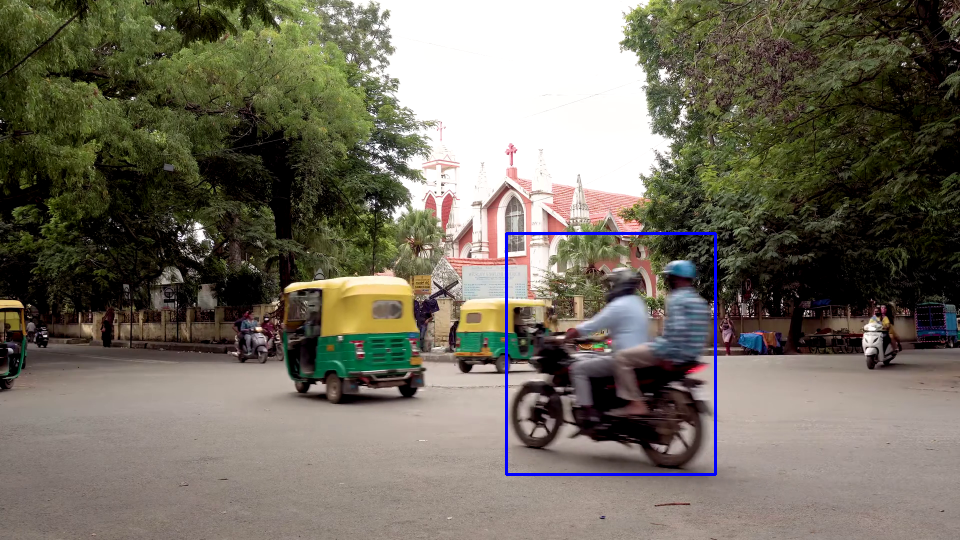

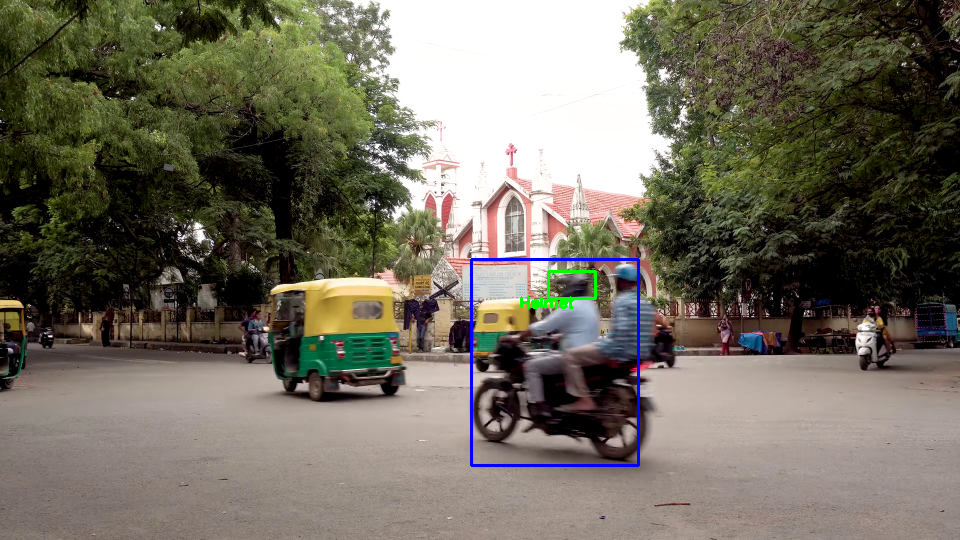

...

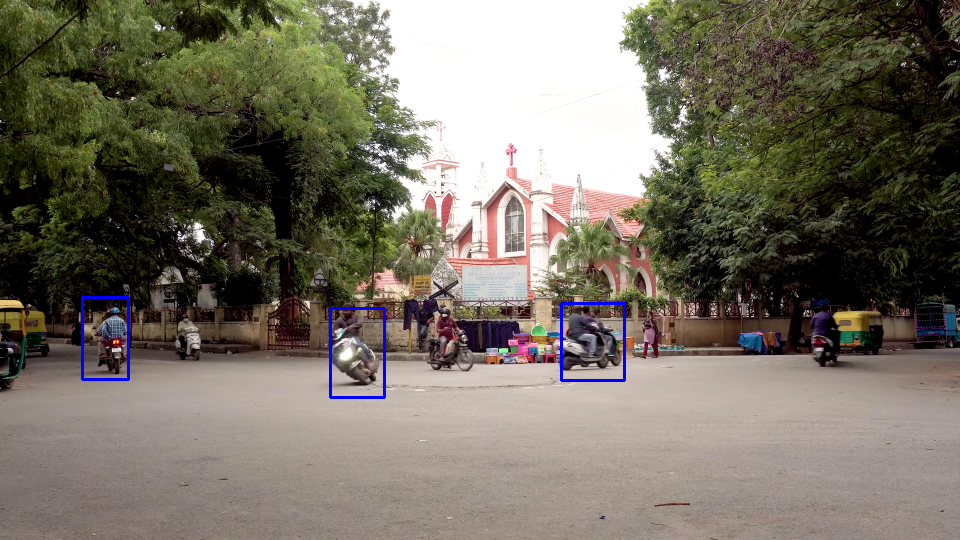

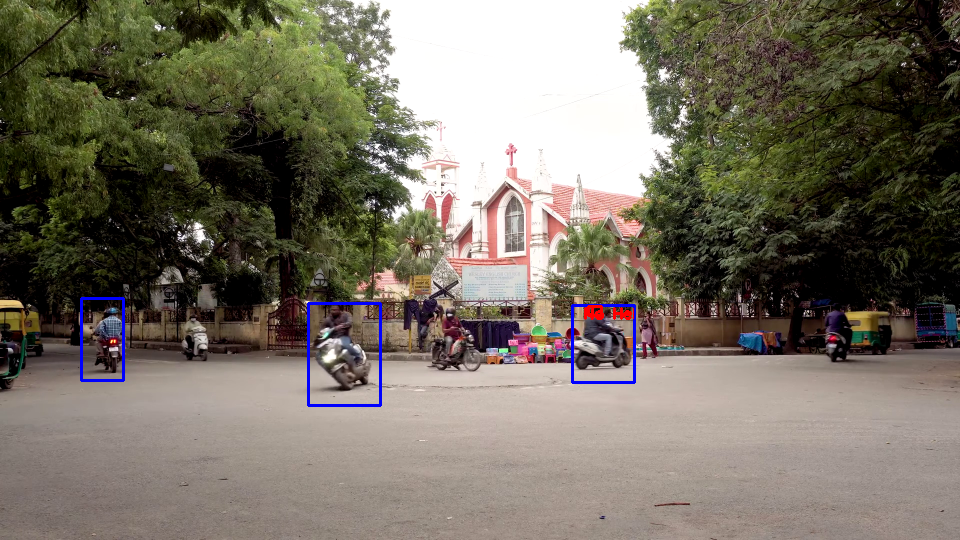

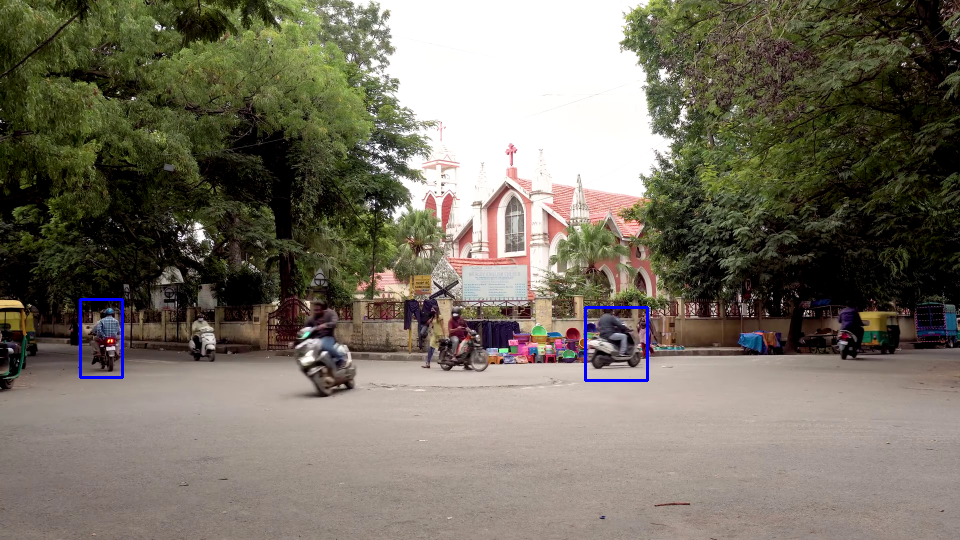

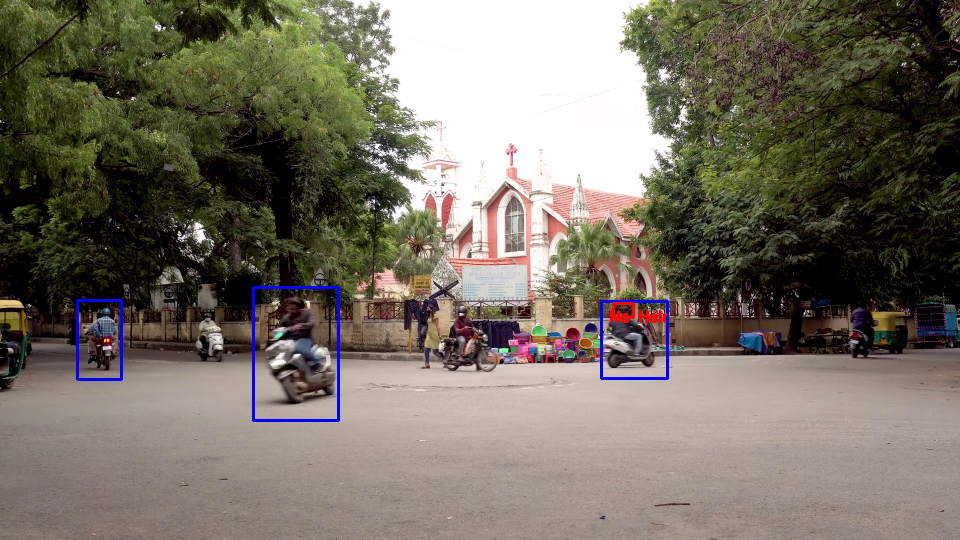

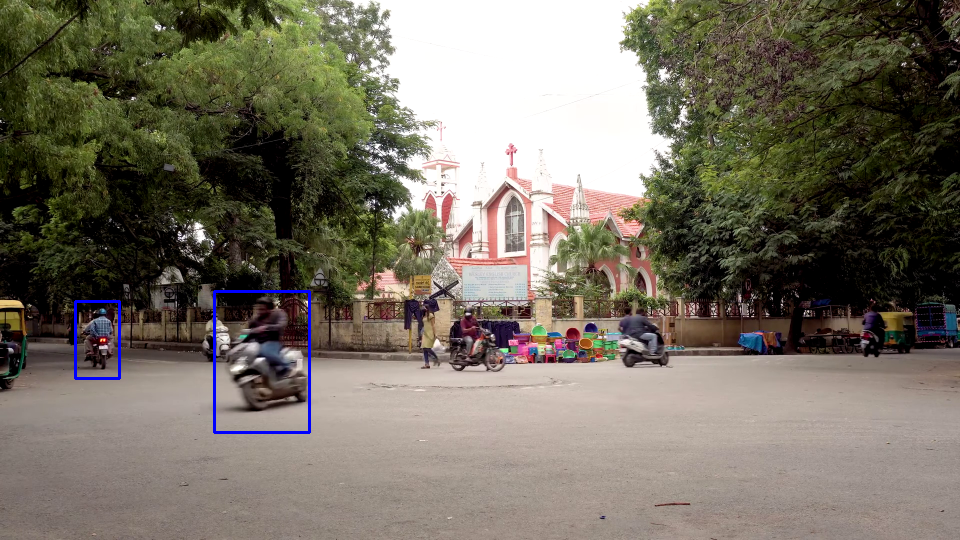

Buffered data was truncated after reaching the output size limit.

In [ ]:

video = cv2.VideoCapture(PATH_TO_VIDEO)

images=[]
f=0
while(video.isOpened()):
  if f%3!=0:
    ret,image = video.read()
    f+=1
    continue
  ret,image = video.read()
  if ret == True:
    image=cv2.resize(image,None,fx=0.5, fy=0.5, interpolation=cv2.INTER_AREA)
    image_expanded = np.expand_dims(image, axis=0)

    # Perform the actual detection by running the model with the image as input
    (boxes, scores, classes, num) = sess.run(
        [detection_boxes, detection_scores, detection_classes, num_detections],
        feed_dict={image_tensor: image_expanded})


    #getting the normalized coordinates of boxes
    normalizedBoxes = np.squeeze(boxes)
    normalizedScores = np.squeeze(scores)
    normalizedClasses = np.squeeze(classes)

    #set a min thresh score, say 0.8
    min_score_thresh = 0.8
    detectedBoxes = normalizedBoxes[normalizedScores > min_score_thresh]
    detectedClasses= normalizedClasses[normalizedScores > min_score_thresh]

    #get image size
    im_height,im_width, _=image.shape
    size=(im_width, im_height)

    #get coordinates of bike riders in image
    final_boxes = []
    for i in range(len(detectedBoxes)):
        ymin, xmin, ymax, xmax = detectedBoxes[i]
        final_boxes.append([xmin * im_width, xmax * im_width, ymin * im_height, ymax * im_height])

    j=0
    for [left,right,top,bottom] in final_boxes:
        l=int(round(left))
        r=int(round(right))
        t=int(round(top))
        b=int(round(bottom))
        croppedImage=image[t:b,l:r]  # Extract each bike rider

        cv2.rectangle(image, (l,t), (r,b), (255,0,0), 2)

        # perform padding to cropped image
        rows = croppedImage.shape[0]
        cols = croppedImage.shape[1]
        padding=0
        if rows > cols:
            padding = int((rows-cols) / 2)
            paddedImg=cv2.copyMakeBorder(croppedImage, 0,0,padding, padding,  cv2.BORDER_CONSTANT, (0, 0, 0))
        else:
            paddedImg=croppedImage

        # image preprocessing for yolo model
        (H, W) = paddedImg.shape[:2]
        blob = cv2.dnn.blobFromImage(paddedImg, 1 / 255.0, (416, 416), swapRB=True, crop=False)

        # run yolo model
        net.setInput(blob)
        layerOutputs = net.forward(ln)

        # Initializing for getting box coordinates, confidences, classid
        boxesH = []
        confidencesH = []
        classIDsH = []
        thresholdH = 0.15

        # getting coordinates of output predictions and performing NMS
        for output in layerOutputs:
            for detection in output:
                confidenceOfEachClass = detection[5:]
                classIDH = np.argmax(confidenceOfEachClass)    # get class with max confidence
                confidenceH = confidenceOfEachClass[classIDH]  # get the max confidence
                if confidenceH > thresholdH:
                    boxH = detection[0:4] * np.array([W, H, W, H])
                    (centerX, centerY, widthH, heightH) = boxH.astype("int")
                    x = int(centerX - (widthH / 2))
                    y = int(centerY - (heightH / 2))
                    boxesH.append([x, y, int(widthH), int(heightH)])
                    confidencesH.append(float(confidenceH))
                    classIDsH.append(classIDH)
        idxs = cv2.dnn.NMSBoxes(boxesH, confidencesH, thresholdH, 0.1)

        # bounding boxes for helmet- no helmet
        if len(idxs) > 0:
            for i in idxs.flatten():
                (x, y) = (boxesH[i][0], boxesH[i][1])
                (w, h) = (boxesH[i][2], boxesH[i][3])
                if LABELS[classIDsH[i]] == 'Helmet':
                    color = (0, 255, 0)
                    cv2.rectangle(croppedImage, (x-padding, y), (x + w-padding, y + h), color, 2)
                    text = "{}".format(LABELS[classIDsH[i]])
                    cv2.putText(croppedImage, text, (x//2, y+ 4*h//3),
                    cv2.FONT_HERSHEY_SIMPLEX,0.5, color, 2)
                if (LABELS[classIDsH[i]] == 'No Helmet'):
                    #store images with no helmet
                    name=VIDEO_NAME.split(".")[0].split('/')[-1]+"_"+str(f)+"_"
                    j+=1
                    cv2.imwrite(PATH_TO_OUTPUT + '{}.jpg'.format(name+str(j)),croppedImage)
                    # draw bounding boxes
                    color = (0, 0, 255)
                    cv2.rectangle(croppedImage, (x-padding, y), (x + w-padding, y + h), color, 2)
                    text = "{}".format(LABELS[classIDsH[i]])
                    cv2.putText(croppedImage, text, (x//2, y + 4* h//3),
                    cv2.FONT_HERSHEY_SIMPLEX,0.5, color, 2)
        images.append(image)
    f+=1
    cv2_imshow(image)
  else:
    break
video.release()

